<a href="https://colab.research.google.com/github/elsoori/CropDoc/blob/main/Cleaned_model_cropdoc.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CropDoc(Soybean leaves)
### Your Toolkit to Growing Healthier Fields

In [23]:
!pip install -Uqq fastai duckduckgo_search fastbook timm

In [24]:
from duckduckgo_search import ddg_images
from fastcore.all import *
from fastai.vision.all import *
from fastbook import *
from fastai.vision.widgets import *
from fastcore.all import *
import timm

In [25]:
from fastdownload import download_url
from time import sleep

In [26]:
from google.colab import drive
drive.mount('/content/hackthonUImodel20', force_remount=True)

Mounted at /content/hackthonUImodel20


In [27]:
def search_images( term, max_images=50):
    print(f"Searching for '{term}'")
    return L(ddg_images(term, max_results=max_images)).itemgot('image')

In [28]:
urls = search_images_ddg('Brown spot mosaic on soybean', max_images=1)
urls[0]

'https://i0.wp.com/www.manitobapulse.ca/wp-content/uploads/2018/06/Alfalfa-mosaic-e1528828927415.jpg'

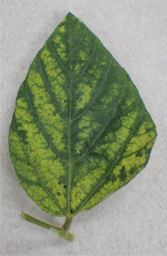

In [29]:
dest = 'Brown spot.jpg'
download_url(urls[0], dest, show_progress=False)

from fastai.vision.all import *
im = Image.open(dest)
im.to_thumb(256,256)

### Now we shall download all the Common Soy Bean Leaf Diseases

In [30]:
disease_types = 'Brown Spot','Bacterial Blight', 'Bacterial Pustule','Frogeye Leaf Spot', 'Cercospora Leaf Blight','Downy Mildew', 'Healthy Soybean Leaf'

path = Path('Soybeans')
from time import sleep

for o in disease_types:
    dest = (path/o)
    dest.mkdir(exist_ok=True, parents =True)
    download_images(dest, urls=search_images(f'{o} in Soybean plant'))
    sleep(1)

    resize_images(path/o, max_size=200, dest=path/o)

Searching for 'Brown Spot in Soybean plant'
Searching for 'Bacterial Blight in Soybean plant'
Searching for 'Bacterial Pustule in Soybean plant'
Searching for 'Frogeye Leaf Spot in Soybean plant'
Searching for 'Cercospora Leaf Blight in Soybean plant'
Searching for 'Downy Mildew in Soybean plant'


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Searching for 'Healthy Soybean Leaf in Soybean plant'


In [31]:
failed = verify_images(get_image_files(path))
failed.map(Path.unlink)
len(failed)

6

In [32]:
Soybeans = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(192))

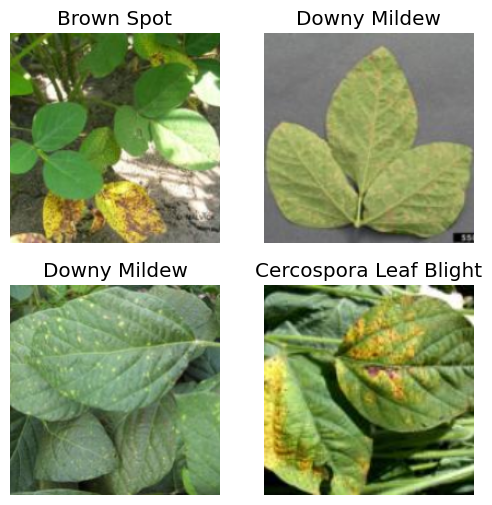

In [33]:
dls = Soybeans.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=2)

In [34]:
Soybeans = Soybeans.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = Soybeans.dataloaders(path)

In [35]:
timm.list_models("convnext*")

['convnext_atto',
 'convnext_atto_ols',
 'convnext_base',
 'convnext_femto',
 'convnext_femto_ols',
 'convnext_large',
 'convnext_large_mlp',
 'convnext_nano',
 'convnext_nano_ols',
 'convnext_pico',
 'convnext_pico_ols',
 'convnext_small',
 'convnext_tiny',
 'convnext_tiny_hnf',
 'convnext_xlarge',
 'convnext_xxlarge',
 'convnextv2_atto',
 'convnextv2_base',
 'convnextv2_femto',
 'convnextv2_huge',
 'convnextv2_large',
 'convnextv2_nano',
 'convnextv2_pico',
 'convnextv2_small',
 'convnextv2_tiny']

In [36]:
learn = vision_learner(dls,'convnextv2_nano', metrics=error_rate).to_fp16()
learn.fine_tune(5)

epoch,train_loss,valid_loss,error_rate,time
0,2.936971,1.733297,0.559055,00:02


epoch,train_loss,valid_loss,error_rate,time
0,1.921772,1.546380,0.519685,00:02
1,1.843466,1.232720,0.425197,00:02
2,1.661820,0.990481,0.299213,00:02
3,1.498030,0.917995,0.314961,00:02
4,1.403070,0.899465,0.314961,00:02


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b80ba204280>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
<function _MultiProcessingDataLoaderIter.__del__ at 0x7b80ba204280>    assert self._parent_pid == os.getpid(), 'can only test a child process'

Traceback (most recent call last):
AssertionError:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
can only test a child process
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b80ba204280>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7b80ba204280>if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'    
self._shutdown_workers()AssertionError
:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
can only test a child process    
if w.is_alive():
  File "/usr/lib/

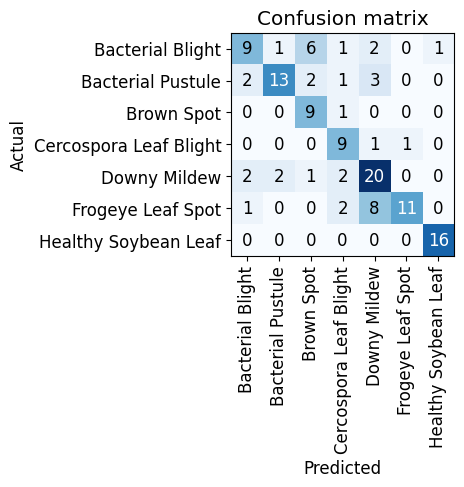

In [40]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

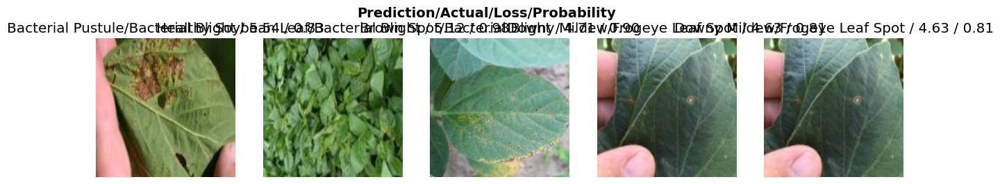

In [41]:
interp.plot_top_losses(5, nrows=1)


In [42]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [47]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change():
  if not cleaner.fns[idx].exists():
      shutil.move(str(cleaner.fns[idx]), path/cat)

In [50]:
learn = vision_learner(dls,'convnextv2_nano', metrics=error_rate).to_fp16()
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,2.946644,1.838944,0.574803,00:02


epoch,train_loss,valid_loss,error_rate,time
0,1.990488,1.604676,0.582677,00:02
1,1.879153,1.328540,0.417323,00:02
2,1.654788,1.150903,0.401575,00:02
3,1.518577,1.107298,0.401575,00:02


In [51]:
learn.export('modelcleanedretrained.pkl')